# Visualize geographic map

One of our purposes in developing the [microgeo](https://github.com/ChaonanLi/microgeo) R package is to rapidly visualize the biogeographic patterns of microbial traits onto maps. Hence, we designed three visualization functions, and all of them return a ggplot2 layer object. The `plot_bmap()` can accept a microgeo-compatible ·SpatialPolygonsDataFrame· returned by `read_aliyun_map()`, `trans_map_fmt()`, `grid_map()`, `merge_dfs_to_map()` or `merge_mtx_to_map()`, and it is only able to visualize the data included in the `SpatialPolygonsDataFrame` itself. The `plot_nmap()` and `plot_imap()` are designed to visualize the results of nearest neighbour and inverse distance weighting interpolations, respectively. 

To add more microbial traits on the ggplot2 layer object, we further implemented four functions of `add_label()`, `add_point()`, `add_spatraster()` and `add_contour`. The `add_label()` can add any characters or numbers in the native polygons of map or the grids created by `grid_map()`. For example, we can apply the gradient colors to represent the average Shannon index in each grid, and simultaneously add the standard errors into each grid by using the `add_label()`. The `add_point()` can add points based on a numeric vector onto a map. By applying such a function, we also can use the size of point to represent the standard errors of Shannon index. Meanwhile, we also can use the gradient colors and/or size of point as a proxy of any microbial trait at each sampling site on maps. 

In the [microgeo](https://github.com/ChaonanLi/microgeo) R package, the functions responsible for predictions based on machine learning model and some spatial interpolations return a `SpatRaster` object. To visualize such a type of data onto maps, we also designed a function of `add_spatraster()`. Meanwhile, we also designed a function of `add_contours()` to convert the data in the `SpatRaster` to contours that can be further rendered onto maps.

Here we need three R packages for this section of [microgeo](https://github.com/ChaonanLi/microgeo) R package tutorial. Just run the following codes to import them into R environment.

In [1]:
suppressMessages(require("magrittr")) 
require("ggplot2")  %>% suppressMessages()
require("microgeo") %>% suppressMessages()

If the Chinese characters cannot be displayed correctly, please run the following codes to set locale to `UTF-8`:

In [2]:
prev_locale <- Sys.setlocale("LC_CTYPE", "C.UTF-8") 

Now, let's go through each of these functions and see how to visualize microbial/environmental traits onto maps.

## 1. Plot a basic map

The [microgeo](https://github.com/ChaonanLi/microgeo) provides two test datasets for the `plot_bmap()` function, where the `common.map.mean` is a `SpatialPolygonsDataFrame` based on administrative divisions and the `gridded.map.mean` is a `SpatialPolygonsDataFrame` processed by `grid_map()`. Below is a simple example of the `plot_bmap()` function.

Let's check the content of `common.map.mean`, a microgeo-compatible `SpatialPolygonsDataFrame`.

In [3]:
# The class of `common.map.mean`
data(common.map.mean)
class(common.map.mean)

[1] "SpatialPolygonsDataFrame"
attr(,"package")
[1] "sp"

In [4]:
# The `common.map.mean` is a microgeo-compatible `SpatialPolygonsDataFrame`
head(common.map.mean@data[,1:12])

,TYPE,FMTS,NAME,X.CENTER,Y.CENTER,observed_mean,shannon_mean,observed_sd,shannon_sd,observed_se,shannon_se,sample.num
,<chr>,<chr>,<chr>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<int>
1,DataV.GeoAtlas,microgeo,西藏自治区,88.38828,31.56375,663.8416,5.846949,239.0407,0.4781792,10.44254,0.02088936,524
2,DataV.GeoAtlas,microgeo,青海省,96.04353,35.72640,647.7036,5.837889,246.2542,0.5396712,11.71312,0.02566954,442
3,DataV.GeoAtlas,microgeo,四川省,102.69345,30.67454,706.8417,5.974116,198.0067,0.3659859,11.87565,0.02195037,278


In [5]:
# Change the name of Polygons
common.map.mean$NAME <- c("Tibet", "Qinghai", "Sichuan") 
head(common.map.mean@data[,1:12]) %>% suppressMessages()

Loading required package: sp

The legacy packages maptools, rgdal, and rgeos, underpinning the sp package,
which was just loaded, will retire in October 2023.
Please refer to R-spatial evolution reports for details, especially
https://r-spatial.org/r/2023/05/15/evolution4.html.
It may be desirable to make the sf package available;
package maintainers should consider adding sf to Suggests:.
The sp package is now running under evolution status 2
     (status 2 uses the sf package in place of rgdal)



,TYPE,FMTS,NAME,X.CENTER,Y.CENTER,observed_mean,shannon_mean,observed_sd,shannon_sd,observed_se,shannon_se,sample.num
,<chr>,<chr>,<chr>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<int>
1,DataV.GeoAtlas,microgeo,Tibet,88.38828,31.56375,663.8416,5.846949,239.0407,0.4781792,10.44254,0.02088936,524
2,DataV.GeoAtlas,microgeo,Qinghai,96.04353,35.72640,647.7036,5.837889,246.2542,0.5396712,11.71312,0.02566954,442
3,DataV.GeoAtlas,microgeo,Sichuan,102.69345,30.67454,706.8417,5.974116,198.0067,0.3659859,11.87565,0.02195037,278


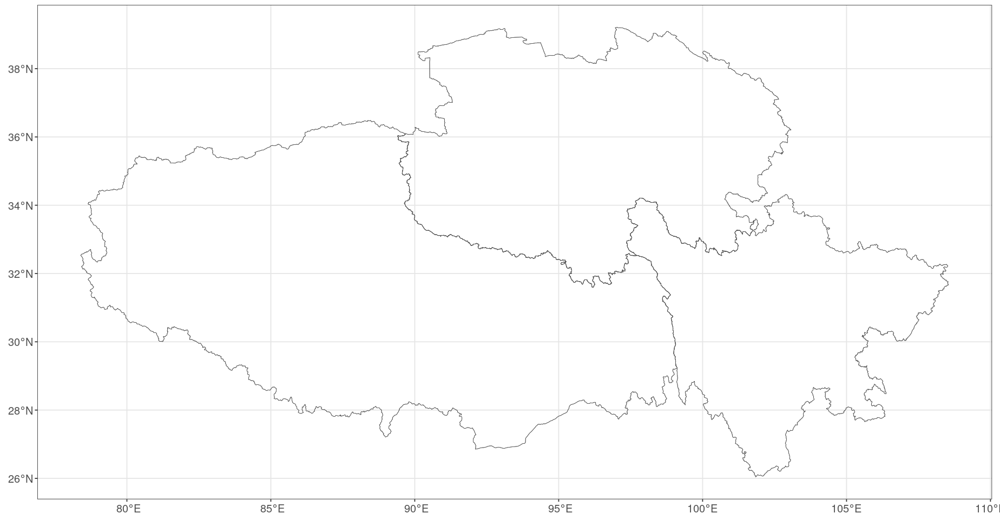

In [6]:
# Plot a basic map without any fill color 
options(repr.plot.width = 15.4, repr.plot.height = 8.02)
(p1 <- common.map.mean %>% plot_bmap(legend.position = c(0.06, 0.25)) %>% suppressMessages())

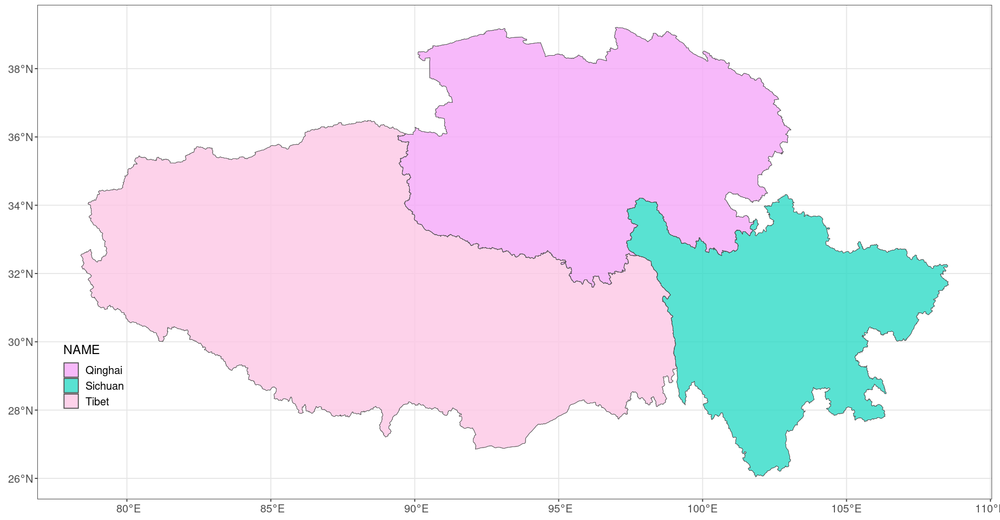

In [7]:
# Plot a basic map with the naive polygons filled by the automatically generated colors based on a character variable
# The fill colors are randomly generated
options(repr.plot.width = 15.4, repr.plot.height = 8.02)
(p2 <- common.map.mean %>% plot_bmap(var = 'NAME', fill = 'auto', legend.position = c(0.06, 0.25)))

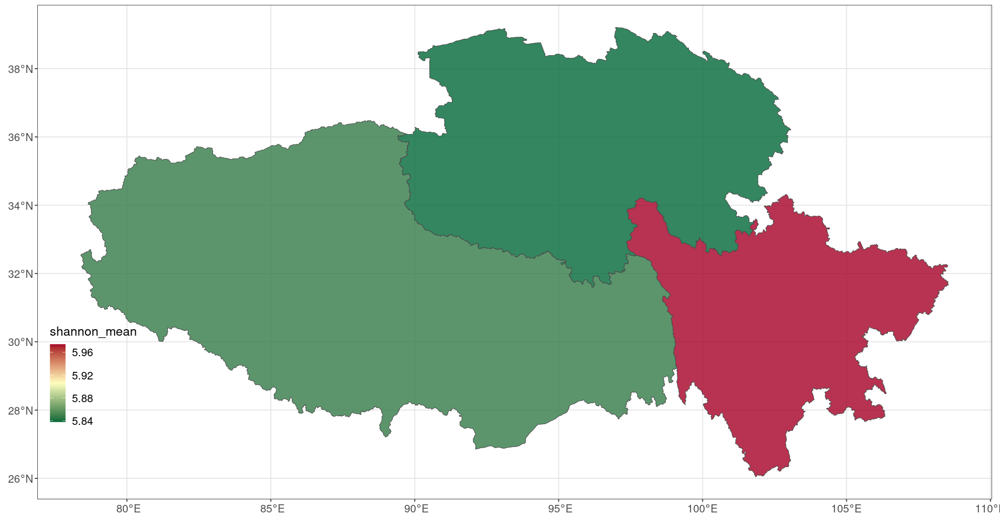

In [8]:
# Plot a basic map with the naive polygons filled by the automatically generated colors based on a numeric variable
options(repr.plot.width = 15.4, repr.plot.height = 8.02)
(p3 <- common.map.mean %>% plot_bmap(var = 'shannon_mean', fill = 'auto', legend.position = c(0.06, 0.255)))

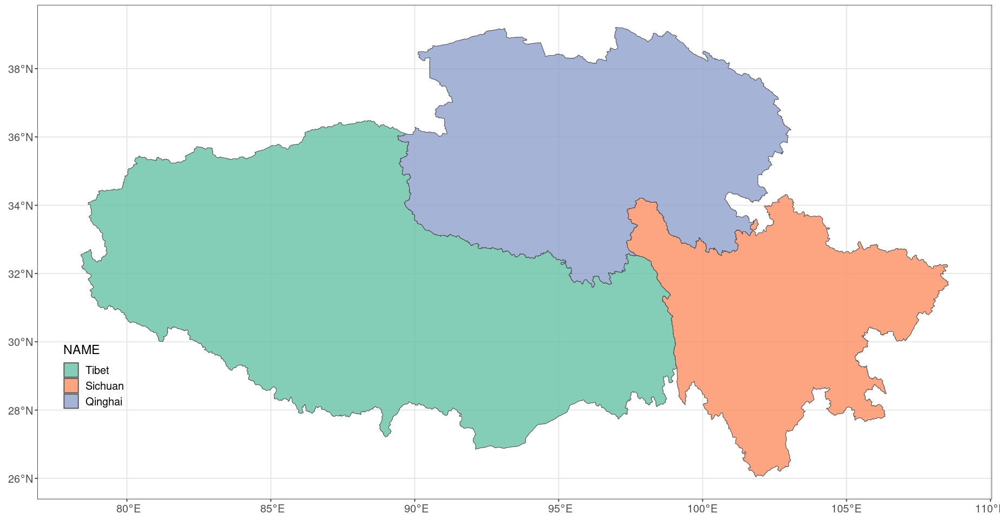

In [9]:
# Plot a basic map with the naive polygons filled by manually set colors based on a character variable
# The display order of polygon names are also manually set
options(repr.plot.width = 15.4, repr.plot.height = 8.02)
(p4 <- common.map.mean %>% plot_bmap(var = 'NAME', fill = RColorBrewer::brewer.pal(8, "Set2")[1:3], 
                                     ord = c('Tibet', 'Sichuan', 'Qinghai'), legend.position = c(0.06, 0.25)))

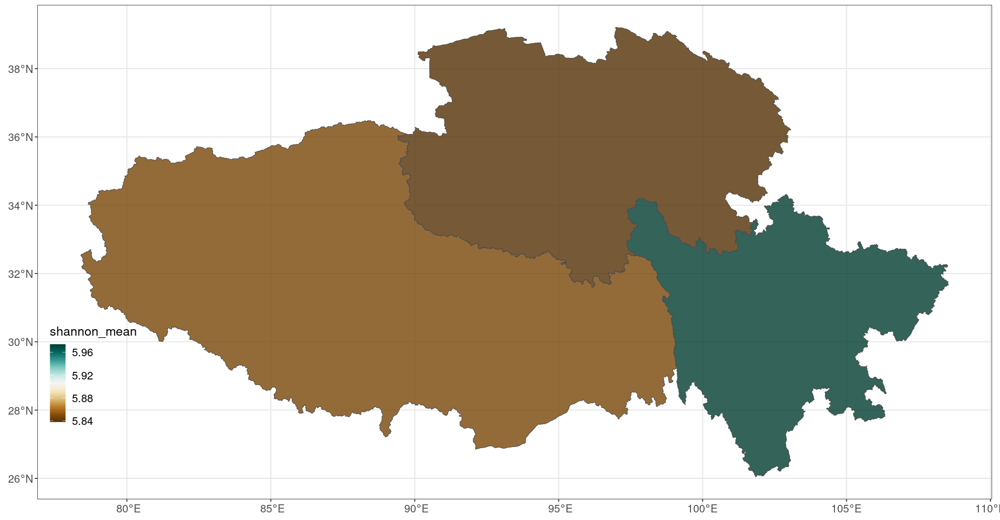

In [10]:
# Plot a basic map with the naive polygons filled by manually set colors based on a numeric variable
options(repr.plot.width = 15.4, repr.plot.height = 8.02)
(p5 <- common.map.mean %>% plot_bmap(var = 'shannon_mean', fill = colorRampPalette(RColorBrewer::brewer.pal(11, "BrBG"))(100), 
                                     legend.position = c(0.06, 0.255)))

Now, let's check the content of `gridded.map.mean`, a microgeo-compatible SpatialPolygonsDataFrame. The `NA` means that there are no samples in the grid. The `NAME` means the grid ID.

In [11]:
# The class of `gridded.map.mean`
data(gridded.map.mean) 
class(gridded.map.mean)

[1] "SpatialPolygonsDataFrame"
attr(,"package")
[1] "sp"

In [12]:
# The `gridded.map.mean` is a microgeo-compatible `SpatialPolygonsDataFrame`
# The `NA` means that there are no samples in the grid. The `NAME` means the grid ID.
head(gridded.map.mean@data[,1:12])

,TYPE,FMTS,NAME,X.CENTER,Y.CENTER,observed_mean,shannon_mean,observed_sd,shannon_sd,observed_se,shannon_se,sample.num
,<chr>,<chr>,<chr>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<int>
1,Gridded.Map,microgeo,1,92.72708,27.05839,NA,NA,NA,NA,NA,NA,NA
2,Gridded.Map,microgeo,2,93.60240,27.08612,NA,NA,NA,NA,NA,NA,NA
3,Gridded.Map,microgeo,3,102.68131,26.73440,NA,NA,NA,NA,NA,NA,NA
4,Gridded.Map,microgeo,4,101.88706,26.72948,NA,NA,NA,NA,NA,NA,NA
5,Gridded.Map,microgeo,5,94.08106,28.05720,NA,NA,NA,NA,NA,NA,NA
6,Gridded.Map,microgeo,6,100.48112,28.28070,NA,NA,NA,NA,NA,NA,NA


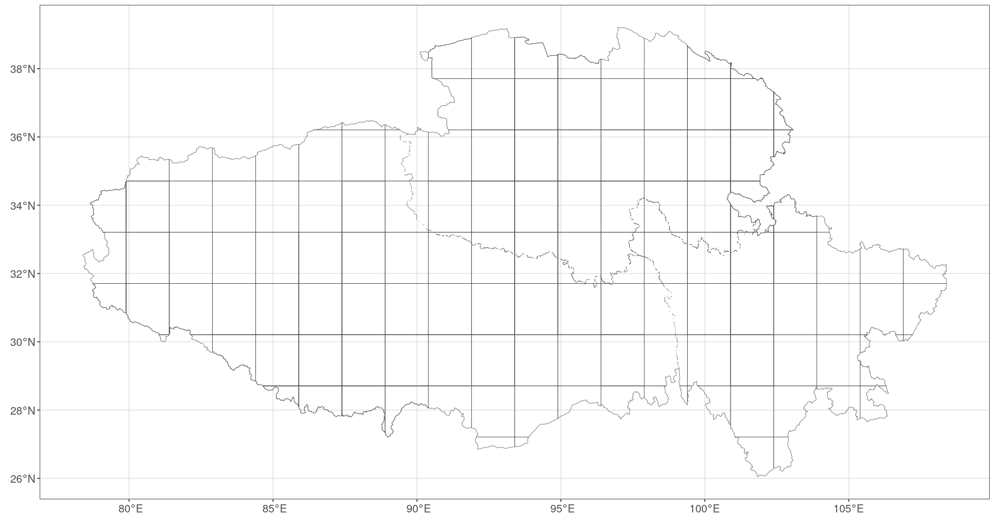

In [13]:
# Plot a gridded map without any fill color 
options(repr.plot.width = 15.4, repr.plot.height = 8.02)
(p6 <- gridded.map.mean %>% plot_bmap(legend.position = c(0.06, 0.25)))

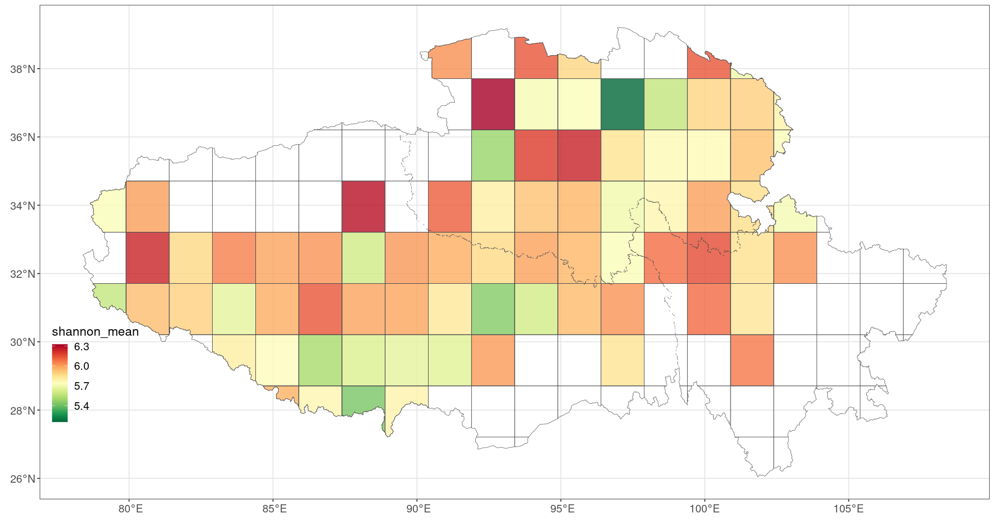

In [14]:
# Plot a gridded map with the grids filled by the automatically generated colors based on a numeric variable
options(repr.plot.width = 15.4, repr.plot.height = 8.02)
(p7 <- gridded.map.mean %>% plot_bmap(var = 'shannon_mean', fill = 'auto', legend.position = c(0.06, 0.255)))

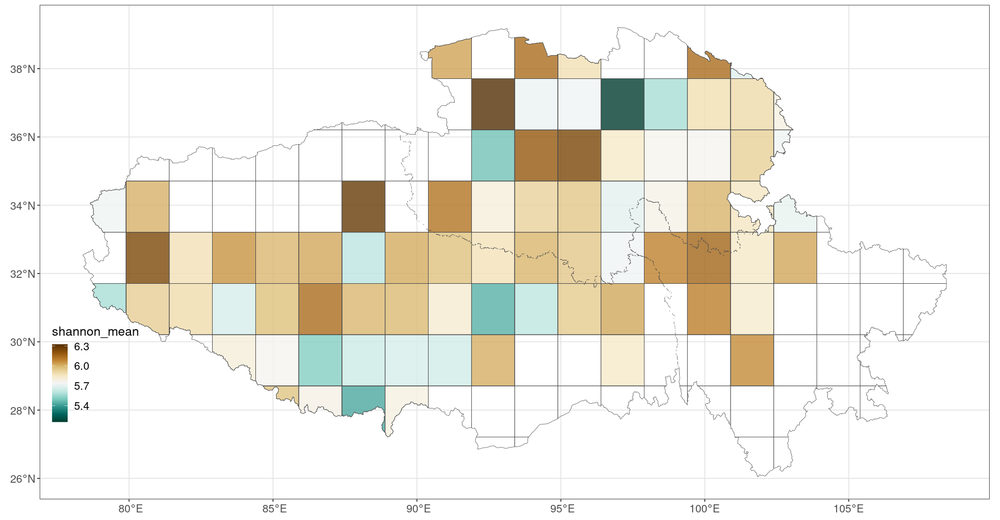

In [15]:
# Plot a gridded map with the grids filled by manually set colors based on a numeric variable
options(repr.plot.width = 15.4, repr.plot.height = 8.02)
(p8 <- gridded.map.mean %>% plot_bmap(var = 'shannon_mean', fill = rev(colorRampPalette(RColorBrewer::brewer.pal(11, "BrBG"))(100)),
                                      legend.position = c(0.06, 0.255)))

## 2. Plot a nearest neighbour interpolation map

We designed a function of `plot_nmap()` to visualize the results of nearest neighbour interpolation. Here, we only give a simple example for the visualization. See details in the tutorial of nearest neighbour interpolation.

Firstly, let's check the content of `nen.interp`.

In [16]:
# The `nen.interp` is a list
data(nen.interp)
class(nen.interp)

[1] "list"

In [17]:
# There are two dataset in `nen.interp` 
names(nen.interp)

[1] "shannon"  "observed"

Then, we use `plot_nmap()` to visualize the `nen.interp`.

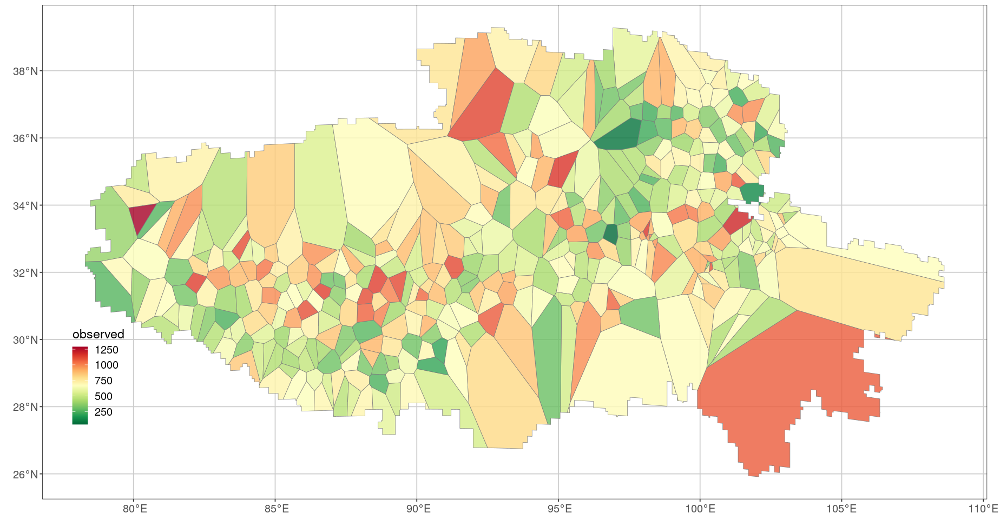

In [18]:
# Plot a map for the results of nearest neighbour interpolation [alpha diversity ==> observed] 
options(repr.plot.width = 15.4, repr.plot.height = 8.02)
(p9 <- nen.interp$observed %>% plot_nmap(legend.position = c(0.06, 0.25)))

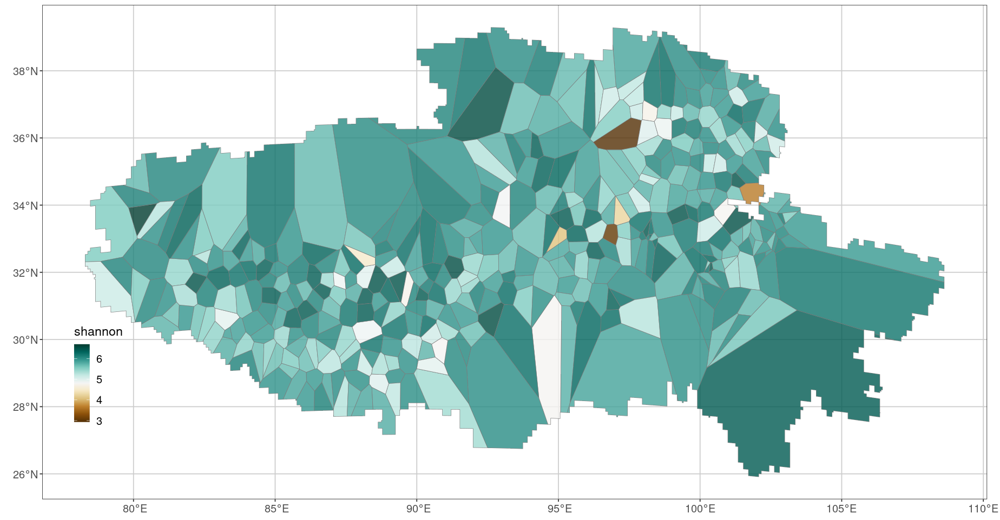

In [19]:
# Plot a map for the results of nearest neighbour interpolation [alpha diversity ==> shannon]; Use manually set colors
options(repr.plot.width = 15.4, repr.plot.height = 8.02)
(p10 <- nen.interp$shannon %>% plot_nmap(fill = colorRampPalette(RColorBrewer::brewer.pal(11, "BrBG"))(100), legend.position = c(0.06, 0.255)))

## 3. Plot an inverse distance weighting (IDW) interpolation map

The [microgeo](https://github.com/ChaonanLi/microgeo) provides two types of inverse distance weighting (IDW) interpolation methods, one of which is hexagonal interpolation. It generates a `sf data.frame` and requires a separate plotting function for visualization. To address this issue, we designed a function of `plot_imap()`. Here, we only give a simple example for visualization. See details in the tutorial of IDW interpolation.

Firstly, let's check the content of `idw.interp.hex`.

In [20]:
# The `idw.interp.hex` is a list
data(idw.interp.hex)
class(idw.interp.hex)

[1] "list"

In [21]:
# There are two dataset in the `idw.interp.hex`
names(idw.interp.hex)

[1] "observed" "shannon"

Then, we use `plot_imap()` to visualize the `idw.interp.hex`.

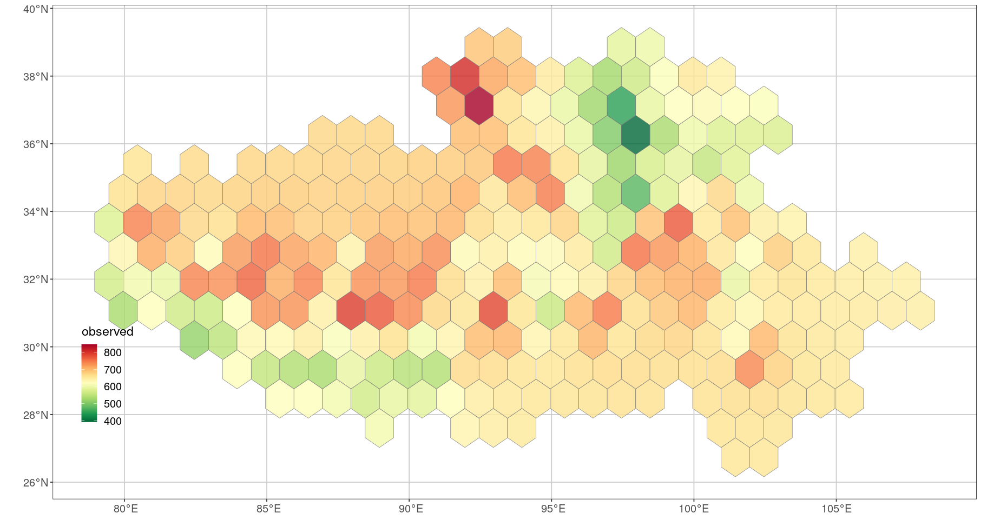

In [22]:
# Plot a map for the results of inverse distance weighting (IDW) interpolation [alpha diversity ==> observed] 
options(repr.plot.width = 15.4, repr.plot.height = 8.02)
(p11 <- idw.interp.hex$observed %>% plot_imap(legend.position = c(0.06, 0.255)))

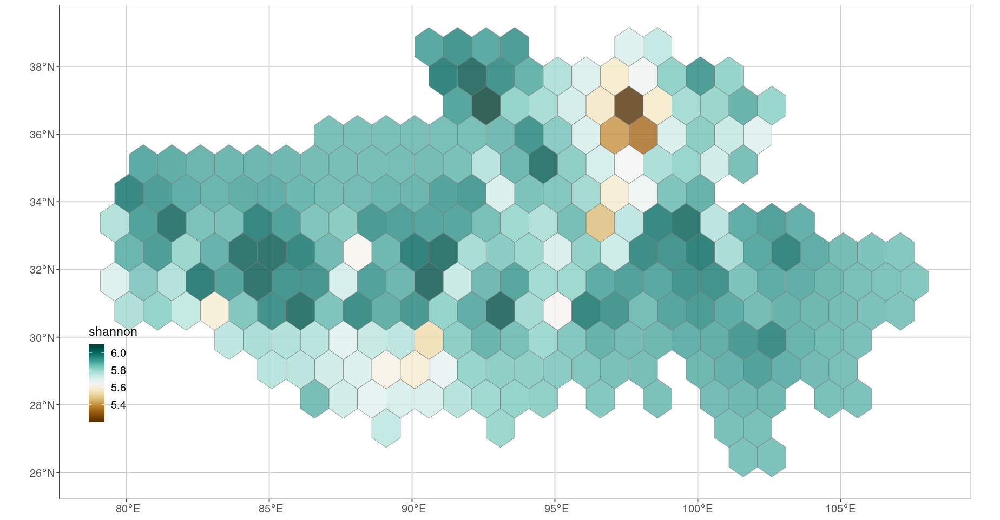

In [23]:
# Plot a map for the results of inverse distance weighting (IDW) interpolation [alpha diversity ==> shannon]; Use manually set colors
options(repr.plot.width = 15.4, repr.plot.height = 8.02)
(p12 <- idw.interp.hex$shannon %>% plot_imap(fill = colorRampPalette(RColorBrewer::brewer.pal(11, "BrBG"))(100), legend.position = c(0.06, 0.255)))

## 4. Add labels onto a map

If you want to add some labels onto maps, the `add_label()` function may be very useful. With the `add_label()`, you can add the names of administrative region, grid names, and any character or numeric variables included in `SpatialPolygonsDataFrame` onto maps. You can even use this function multiple times to add multiple labels onto maps. Here are a few simple examples.

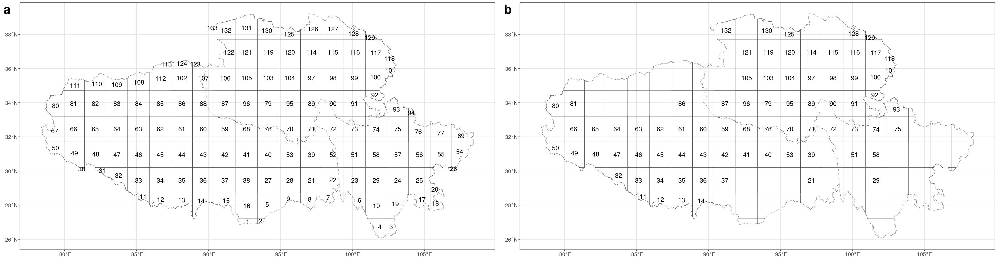

In [24]:
# Add the NAME of grid on the map
options(repr.plot.width = 15.4 * 2, repr.plot.height = 8.02)
p13 <- p6 %>% add_label(dat = gridded.map.mean@data, lab.var = 'NAME', lon.var = 'X.CENTER', 
                        lat.var = 'Y.CENTER', size = 5, remove.na = FALSE) # show all grid names 
p14 <- p6 %>% add_label(dat = gridded.map.mean@data, lab.var = 'NAME', lon.var = 'X.CENTER', 
                        lat.var = 'Y.CENTER', size = 5, remove.na = TRUE) # only show the names of grid covered by field sampling 
cowplot::plot_grid(p13, p14, align = 'hv', ncol = 2, label_size = 28, labels = c("a", "b")) %>% suppressWarnings()

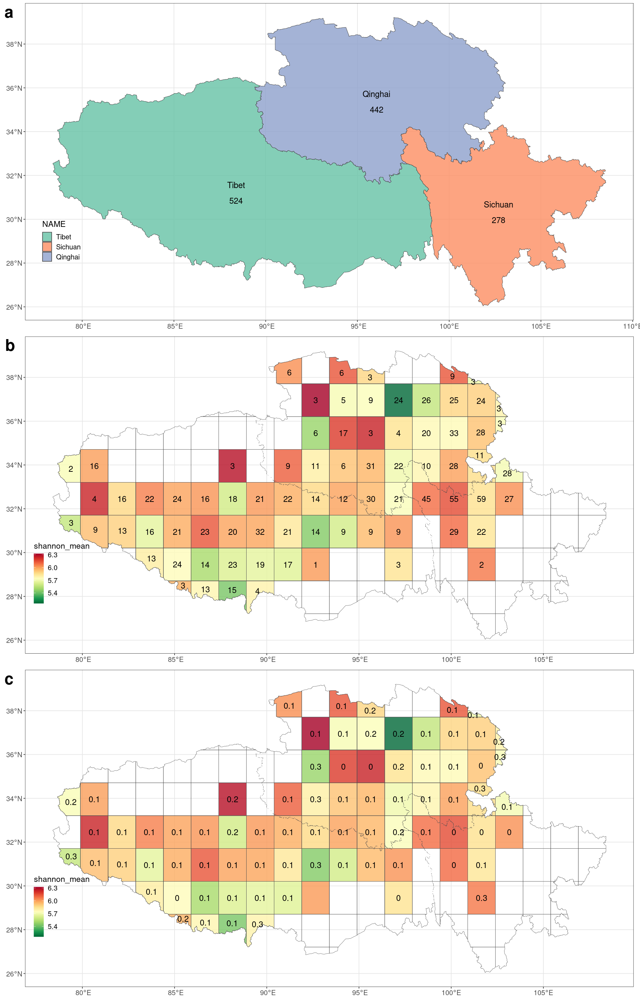

In [25]:
# Add the names of naive polygons and sample number in each naive polygon onto the map 
options(repr.plot.width = 15.4, repr.plot.height = 8.02 * 3)
p15 <- p4 %>% 
    add_label(dat = common.map.mean@data, lab.var = 'NAME', lon.var = 'X.CENTER', lat.var = 'Y.CENTER', size = 5) %>% 
    add_label(dat = common.map.mean@data, lab.var = 'sample.num', lon.var = 'X.CENTER', lat.var = 'Y.CENTER', size = 5, vjust = 3) %>% suppressWarnings()

# Add the sample number of each grid onto the map
p16 <- p7 %>% add_label(dat = gridded.map.mean@data, lab.var = 'sample.num', lon.var = 'X.CENTER', lat.var = 'Y.CENTER', size = 5, remove.na = F)

# Add the standard errors of shannon index in each grid on the map 
# Grids without labels mean that the samples are not enough for the calculation of standard error (at least two samples are required)
p17 <- p7 %>% add_label(dat = gridded.map.mean@data, lab.var = 'shannon_se', lon.var = 'X.CENTER', lat.var = 'Y.CENTER', size = 5, remove.na = F) 

# Display the figure
cowplot::plot_grid(p15, p16, p17, align = 'hv', ncol = 1, label_size = 28, labels = c("a", "b", "c")) %>% suppressWarnings()

## 5. Add points onto a map

In some cases, we want to display additional data onto the map processed by `grid_map()`. For example, we need to display the mean and standard error of the Shannon index in each grid at the same time. The first option is to represent the mean by the color of the grid, and then use the `add_label()` function to directly add the value of the standard error to the grid. Another option is to use `add_point()` function, which adds points to each grid, with the size of the point representing the standard error.

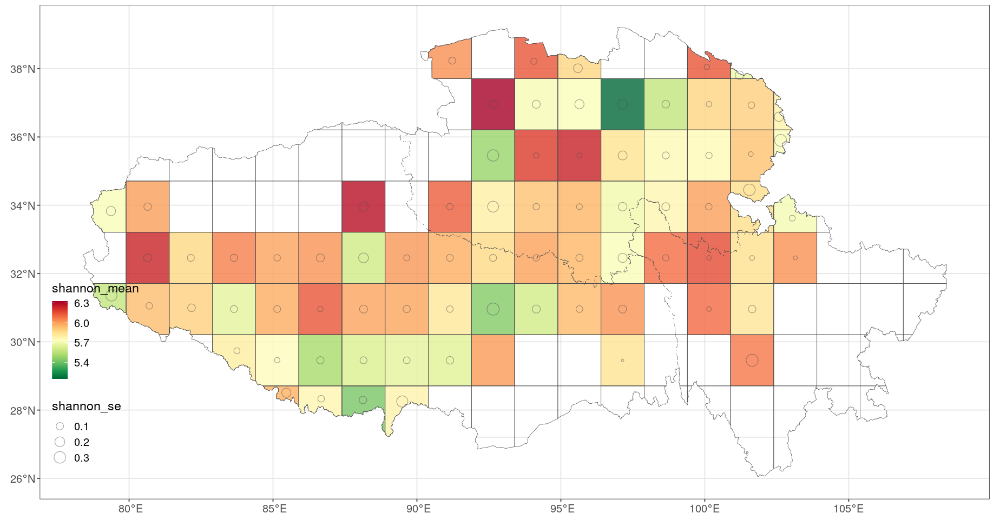

In [26]:
# Add points onto a gridded map by using the standard error of shannon index in each grid
# Grids without point mean that the samples are not enough for the calculation of standard error (at least two samples are required)
options(repr.plot.width = 15.4, repr.plot.height = 8.02)
(p18 <- p7 %>% add_point(dat = gridded.map.mean@data, lab.var = 'shannon_se', 
                              lon.var = "X.CENTER", lat.var = "Y.CENTER", remove.na = TRUE) )# Remove all NA

You also can use the `add_point()` to visualize a numeric variable onto maps. For example, we can visualize the soil pH of each sampling site onto maps. The below is a simple example. 

In [27]:
# Create a microgeo dataset. See subsequent tutorial for details. 
data(qtp)
map <- read_aliyun_map(adcode = c(540000, 630000, 510000))
dataset.dts <- create_dataset(mat = qtp$asv, ant = qtp$tax, met = qtp$met, map = map, 
                              phy = qtp$tre, env = qtp$env, lon = "longitude", lat = "latitude")
dataset.dts %<>% tidy_dataset() 

ℹ [2024-01-13 01:55:50] INFO ==> all samples fall within the map area!

ℹ [2024-01-13 01:55:50] INFO ==> dataset has been created successfully!

ℹ [2024-01-13 01:55:50] INFO ==> use `object %>% show_dataset()` to check the summary of dataset.



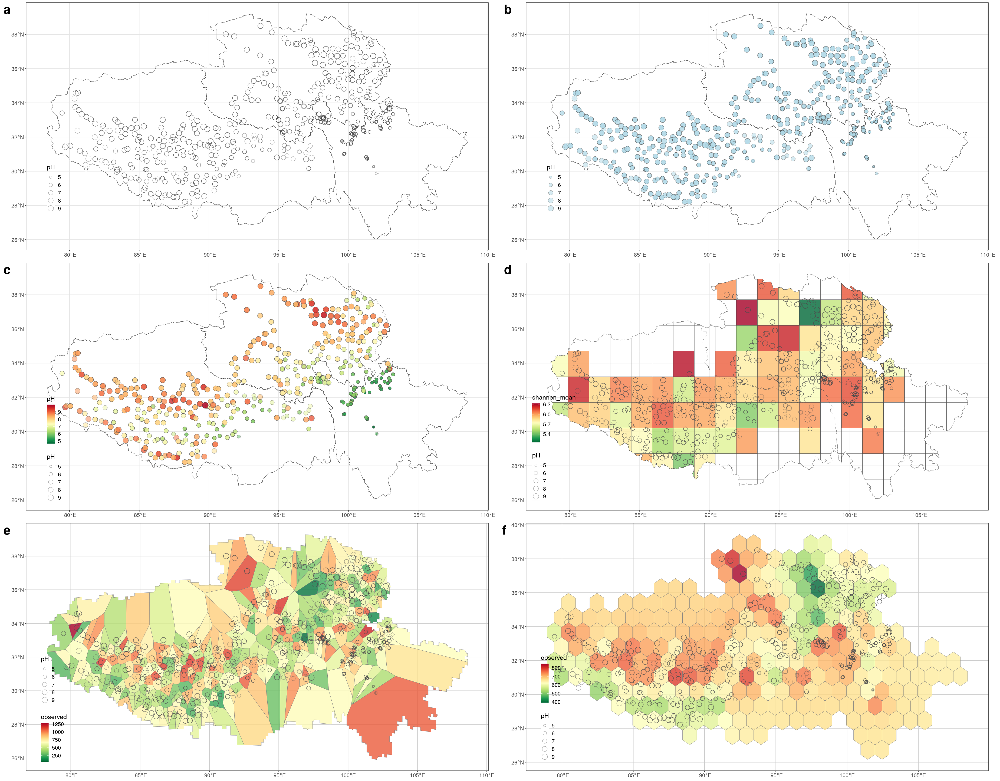

In [28]:
# Visualize the soil pH of each sampling site onto maps
options(repr.plot.width = 15.4 * 2, repr.plot.height = 8.02 * 3)
dat <- cbind(dataset.dts$met, dataset.dts$env)
p19 <- p1  %>% add_point(dat = dat, lab.var = 'pH') 
p20 <- p1  %>% add_point(dat = dat, lab.var = 'pH', fill = 'lightblue') 
p21 <- p1  %>% add_point(dat = dat, lab.var = 'pH', fill = rev(colorRampPalette(RColorBrewer::brewer.pal(11, 'RdYlGn'))(100)))
p22 <- p7  %>% add_point(dat = dat, lab.var = 'pH') 
p23 <- p9  %>% add_point(dat = dat, lab.var = 'pH')
p24 <- p11 %>% add_point(dat = dat, lab.var = 'pH')
cowplot::plot_grid(p19, p20, p21, p22, p23, p24, align = 'hv', ncol = 2, label_size = 28, 
                   labels = c("a", "b", "c", "d", "e", "f")) %>% suppressWarnings()

## 6. Add SpatRasters onto a map

In some cases, we need to visualize `SpatRaster` data. For example, spatial datasets (e.g., aridity index, annual average temperature, and soil pH) downloaded from public databases, and the results returned by some spatial interpolation functions and machine learning prediction functions in the [microgeo](https://github.com/ChaonanLi/microgeo) R package. Regarding the visualization of `SpatRaster` data, we designed a function of `add_spatraster()`. Here are a few simple examples.

In [29]:
# Create a microgeo dataset. See subsequent tutorial for details. 
data(qtp)
map <- read_aliyun_map(adcode = c(540000, 630000, 510000))
dataset.dts <- create_dataset(mat = qtp$asv, ant = qtp$tax, met = qtp$met, map = map,
                              phy = qtp$tre, env = qtp$env, lon = "longitude", lat = "latitude") 

ℹ [2024-01-13 01:55:59] INFO ==> all samples fall within the map area!

ℹ [2024-01-13 01:55:59] INFO ==> dataset has been created successfully!

ℹ [2024-01-13 01:55:59] INFO ==> use `object %>% show_dataset()` to check the summary of dataset.



In [30]:
# Download phh2o from soilgrid database.
dataset.dts %<>% get_soilgrid(depth = 5, measures = c('phh2o'), out.dir = "test") 

✔ [2024-01-13 01:56:00] SAVE ==> results have been saved to: object$spa$rast$his$phh2o



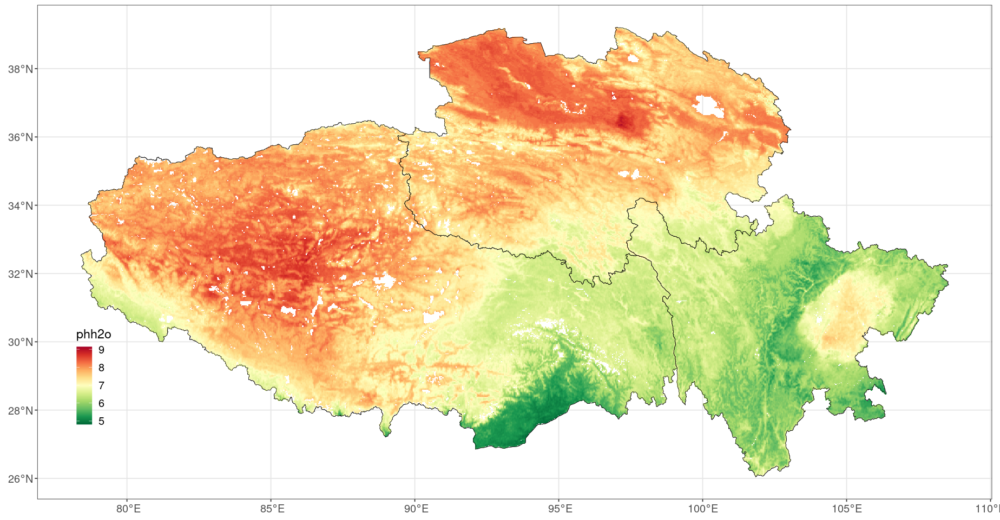

In [31]:
# Add the SpatRaster data of soil pH onto a map 
options(repr.plot.width = 15.4, repr.plot.height = 8.02)
(p25 <- p1 %>% add_spatraster(spat.raster = dataset.dts$spa$rast$his$phh2o))

Notably, the `add_spatraster()` function would fill the whole study area. However, in some cases, we only focus one or two ecosystems, for example, grassland, forest or barren. To address this problem, we also implemented a function of `mask_spatraster_by_cla()`, which can mask off those areas that we are not interested in. Here are a few simple examples.

In [32]:
# Download classification MODIS metrics of research region. 
# Please provide correct username and password. Run `?get_modis_cla_metrics()` to see more details.
dataset.dts %<>% get_modis_cla_metrics(username = "username", password = "password", out.dir = "test") 

ℹ [2024-01-13 01:56:03] INFO ==> preparing MODIS product list for searching...

ℹ [2024-01-13 01:56:03] INFO ==> searching avaliable MODIS products...

ℹ [2024-01-13 01:56:03] INFO ==> current product (1/1): MCD12Q1 (LC_Type1--> 2022-01-01 to 2022-12-31)

ℹ [2024-01-13 01:56:05] INFO ==> find 8 files with 0.09 GB in total...

ℹ [2024-01-13 01:56:05] INFO ==> downloading all avaliable MODIS products[skip if the file exists]...

ℹ [2024-01-13 01:56:05] INFO ==> preparing the PTVs (Product, Time, Version) for merging remote-sensing images...

ℹ [2024-01-13 01:56:05] INFO ==> converting hdf files to tif files...

ℹ [2024-01-13 01:56:05] INFO ==> current product (1/1): MCD12Q1 (convert 8 hdf files into 1 tif files using 1 threads)

ℹ [2024-01-13 01:56:05] INFO ==> collecting all merged image files...

ℹ [2024-01-13 01:56:05] INFO ==> current measure (1/1): LC_Type1_061

ℹ [2024-01-13 01:56:05] INFO ==> reprojecting the CRS of SpatRaster to epsg:+proj=longlat +datum=WGS84 +no_defs, it takes 

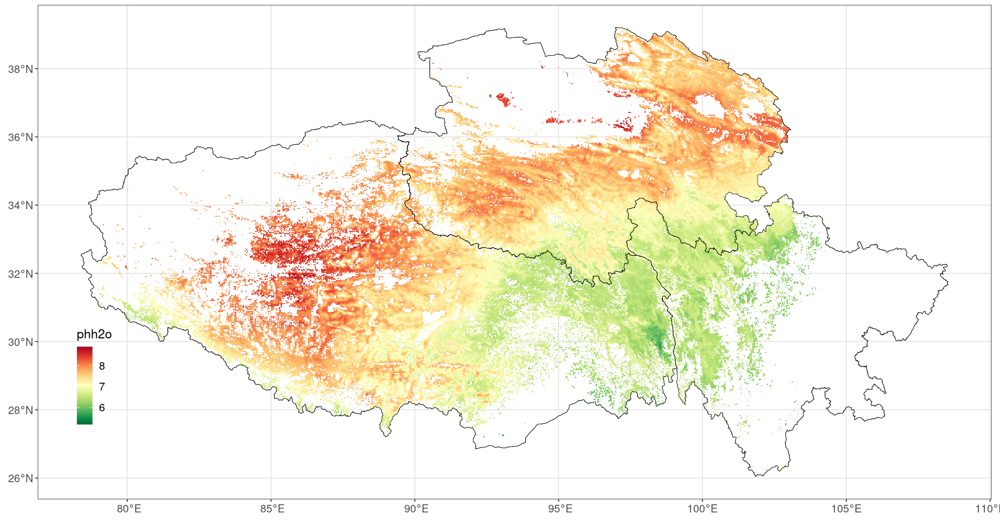

In [33]:
# Mask the results by using grassland(10); Run `?get_modis_cla_metrics()` to see more details.
options(repr.plot.width = 15.4, repr.plot.height = 8.02)
m1 <- mask_spatraster_by_cla(tar.spat = dataset.dts$spa$rast$his$phh2o, ref.spat = dataset.dts$spa$rast$cla$LC_Type1, use.class = 10)
(p26 <- p1 %>% add_spatraster(spat.raster = m1))

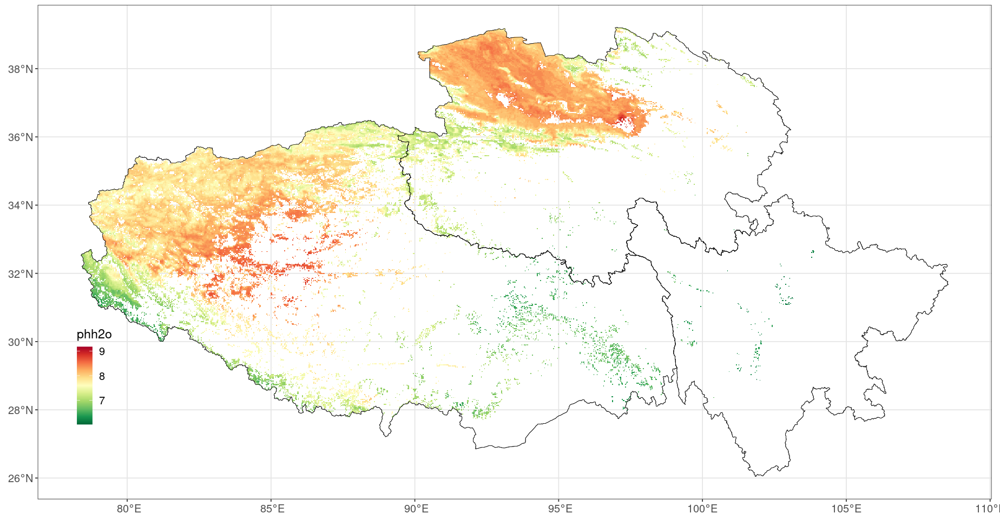

In [34]:
# Mask the results by using barren(16); Run `?get_modis_cla_metrics()` to see more details.
options(repr.plot.width = 15.4, repr.plot.height = 8.02)
m2 <- mask_spatraster_by_cla(tar.spat = dataset.dts$spa$rast$his$phh2o, ref.spat = dataset.dts$spa$rast$cla$LC_Type1, use.class = 16)
(p27 <- p1 %>% add_spatraster(spat.raster = m2))

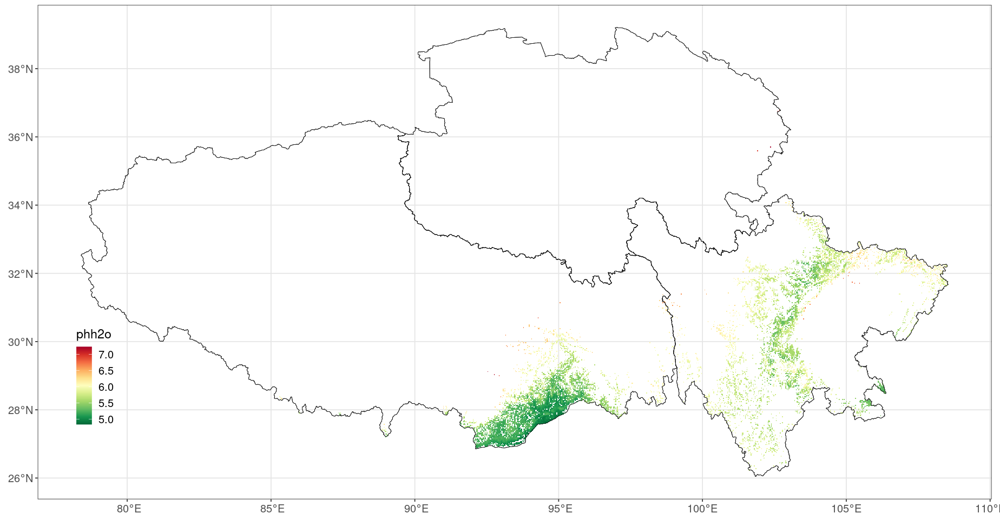

In [35]:
# Mask the results by using forest (1,2,3,4,5); Run `?get_modis_cla_metrics()` to see more details.
options(repr.plot.width = 15.4, repr.plot.height = 8.02)
m3 <- mask_spatraster_by_cla(tar.spat = dataset.dts$spa$rast$his$phh2o, ref.spat = dataset.dts$spa$rast$cla$LC_Type1, use.class = c(1,2,3,4,5))
(p28 <- p1 %>% add_spatraster(spat.raster = m3))

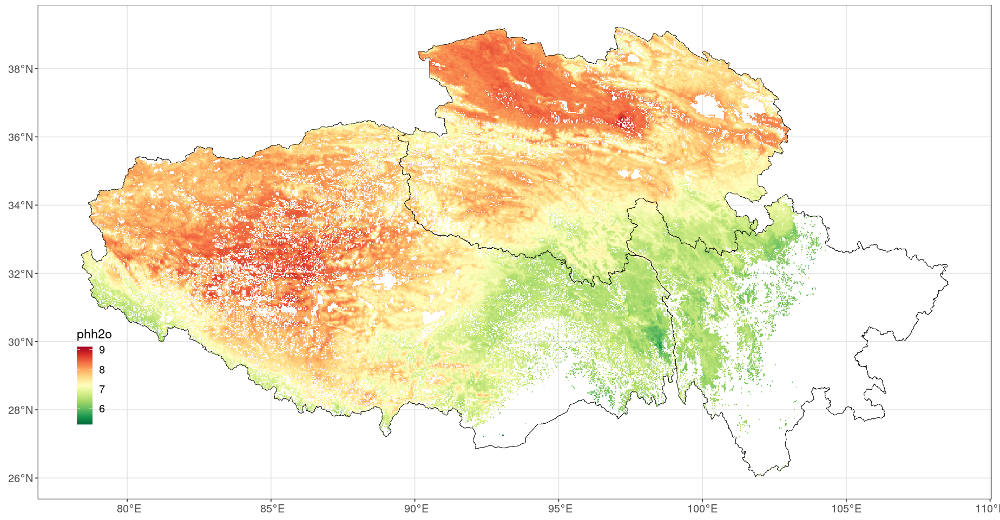

In [36]:
# Mask the results by using grassland (10) and barren (16); Run `?get_modis_cla_metrics()` to see more details.
options(repr.plot.width = 15.4, repr.plot.height = 8.02)
m4 <- mask_spatraster_by_cla(tar.spat = dataset.dts$spa$rast$his$phh2o, ref.spat = dataset.dts$spa$rast$cla$LC_Type1, use.class = c(10, 16))
(p29 <- p1 %>% add_spatraster(spat.raster = m4))

## 7. Add contours onto a map

You also can convert the `SpatRaster` returned by spatial interpolation functions or machine learning prediction functions to contours, and further add these contours onto maps by using `add_contour()`. Here are a few simple examples.

In [37]:
# Create a microgeo dataset. See subsequent tutorial for details. 
data(qtp)
map <- read_aliyun_map(adcode = c(540000, 630000, 510000))
dataset.dts <- create_dataset(mat = qtp$asv, ant = qtp$tax, met = qtp$met, map = map,
                              phy = qtp$tre, env = qtp$env, lon = "longitude", lat = "latitude") 
dataset.dts %<>% rarefy_count_table() 
dataset.dts %<>% tidy_dataset()
dataset.dts %<>% calc_alpha_div(measures = c("observed", "shannon"))

ℹ [2024-01-13 01:57:20] INFO ==> all samples fall within the map area!

ℹ [2024-01-13 01:57:20] INFO ==> dataset has been created successfully!

ℹ [2024-01-13 01:57:21] INFO ==> use `object %>% show_dataset()` to check the summary of dataset.

ℹ [2024-01-13 01:57:23] INFO ==> the ASV/gene abundance table has been rarefied with a sub-sample depth of 5310

✔ [2024-01-13 01:57:27] SAVE ==> results have been saved to: object$div$alpha



In [38]:
# Perform kriging interpolation for shannon diversity indices.
kri.rst.shannon <- interp_kri(map = dataset.dts$map, met = dataset.dts$met, dat = dataset.dts$div$alpha, 
                              var = 'shannon', model = 'Mat', trim.dup = TRUE) %>% suppressMessages()

[using ordinary kriging]


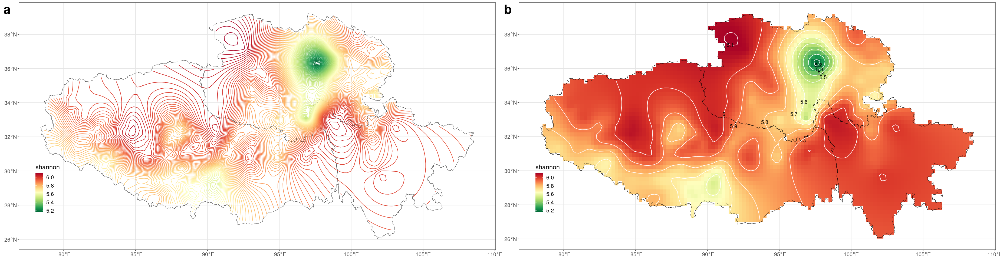

In [39]:
# Add contours on the map 
options(repr.plot.width = 15.4 * 2, repr.plot.height = 8.02)
p30 <- p1 %>% add_contour(spat.raster = kri.rst.shannon, nlevels = 100)
p31 <- p1 %>% add_spatraster(spat.raster = kri.rst.shannon) %>% add_contour(spat.raster = kri.rst.shannon, nlevels = 10, color = 'white', show.labels = TRUE)
cowplot::plot_grid(p30, p31, align = 'hv', ncol = 2, label_size = 28, labels = c("a", "b")) %>% suppressWarnings()

## 8. Add north arrow onto a map

We designed a function of `add_north_arrow()` to add a north arrow onto the map. You can use `?add_north_arrow()` to view the built-in document. Here are a few simple examples.

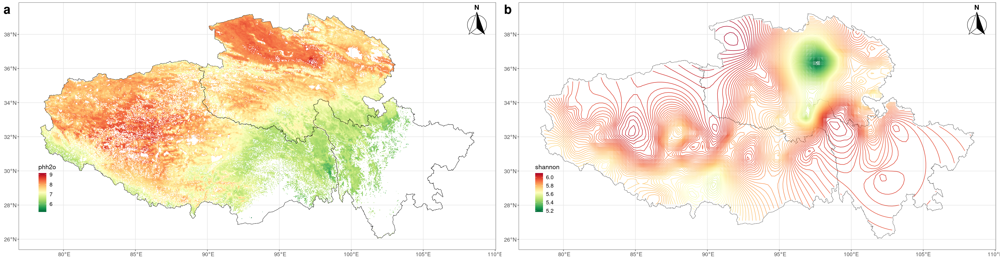

In [40]:
# Add a north arrow on the map
options(repr.plot.width = 15.4 * 2, repr.plot.height = 8.02)
p32 <- p29 %>% add_north_arrow() %>% suppressWarnings()
p33 <- p30 %>% add_north_arrow() %>% suppressWarnings()
cowplot::plot_grid(p32, p33, align = 'hv', ncol = 2, labels = c("a", "b"), label_size = 28) %>% suppressWarnings()

## 9. Add spatial-aware scale bar onto a map

We designed a function of `add_scale_bar()` to add a spatial-aware scale bar onto the map. You can use `?add_scale_bar()` to view the built-in document. Here are a few simple examples.

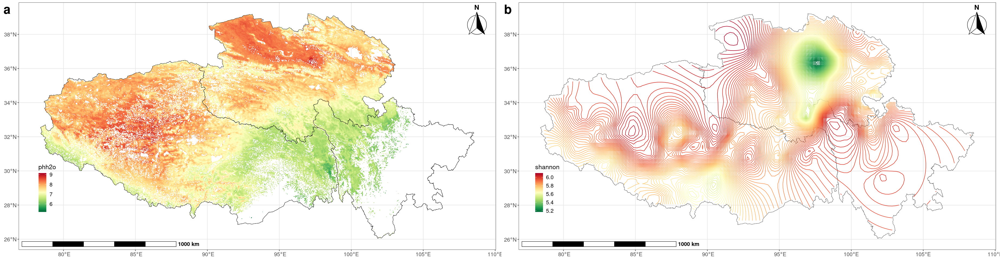

In [41]:
# Add a spatial-aware scale bar on the map
options(repr.plot.width = 15.4 * 2, repr.plot.height = 8.02)
p34 <- p32 %>% add_scale_bar()
p35 <- p33 %>% add_scale_bar()
cowplot::plot_grid(p34, p35, align = 'hv', ncol = 2, labels = c("a", "b"), label_size = 28) %>% suppressWarnings() %>% suppressMessages()

## 10. Add CRS onto a map before final visualization

We designed a function of `add_crs()` to add a coordinate reference system to the map before final visualization. You can use `?add_crs()` to view the built-in document. Here are a few simple examples.

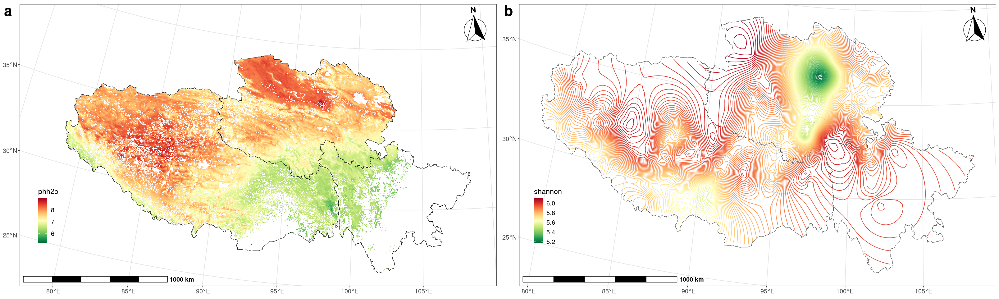

In [42]:
# Add a coordinate reference system to the map before final visualization
options(repr.plot.width = 13.4 * 2, repr.plot.height = 8.02)
p36 <- p34 %>% add_crs()
p37 <- p35 %>% add_crs()
cowplot::plot_grid(p36, p37, align = 'hv', ncol = 2, labels = c("a", "b"), label_size = 28) %>% suppressWarnings() %>% suppressMessages()

## 11. Add sampling sites onto a map

In the large-scale microbial biogeographical studies, another application of [microgeo](https://github.com/ChaonanLi/microgeo) is to display sample point distribution maps. In the [microgeo](https://github.com/ChaonanLi/microgeo) R package, we provide a flexible `add_sampl_site()` function, which can render sampling points on the map. Here are a few simple examples.

In [43]:
# Create a microgeo dataset. See subsequent tutorial for more details.
data(qtp)
map <- read_aliyun_map(adcode = c(540000, 630000, 510000))
dataset.dts <- create_dataset(mat = qtp$asv, ant = qtp$tax, met = qtp$met, map = map,
                              phy = qtp$tre, env = qtp$env, lon = "longitude", lat = "latitude") 
dataset.dts %<>% get_his_bioc(res = 10, out.dir = "test") 
dataset.dts %<>% get_soilgrid(depth = 5, measures = c('phh2o'), out.dir = "test") 
dataset.dts %<>% get_ai(out.dir = "test") # To address the error of `b56e9b573aafae51462e': Timeout of 60 seconds was reached`, run `options(timeout=60000)`
dataset.dts %<>% extract_data_from_spatraster(type = 'his') 
dataset.dts %<>% tidy_dataset()

ℹ [2024-01-13 01:57:42] INFO ==> all samples fall within the map area!

ℹ [2024-01-13 01:57:42] INFO ==> dataset has been created successfully!

ℹ [2024-01-13 01:57:42] INFO ==> use `object %>% show_dataset()` to check the summary of dataset.

✔ [2024-01-13 01:57:43] SAVE ==> results have been saved to: object$spa$rast$his(19 variables)

✔ [2024-01-13 01:57:44] SAVE ==> results have been saved to: object$spa$rast$his$phh2o

✔ [2024-01-13 01:57:49] SAVE ==> results have been saved to: object$spa$rast$his$AI

! [2024-01-13 01:57:49] WARN ==> Some samples were failed to be applied for extraction. use `remove.na = FALSE` to check them!

✔ [2024-01-13 01:57:49] SAVE ==> results have been saved to: object$spa$tabs



In [44]:
# Add two grouping variable in `dataset.dts$met`
dataset.dts$met$GA <- cut(dataset.dts$spa$tabs$AI, breaks = c(-Inf, 0.2, 0.5, Inf), labels = c("A1", "B1", "C1"))
dataset.dts$met$GM <- cut(dataset.dts$spa$tabs$Bio1, breaks = c(-Inf, -1, 1, Inf), labels = c("A2", "B2", "C2"))

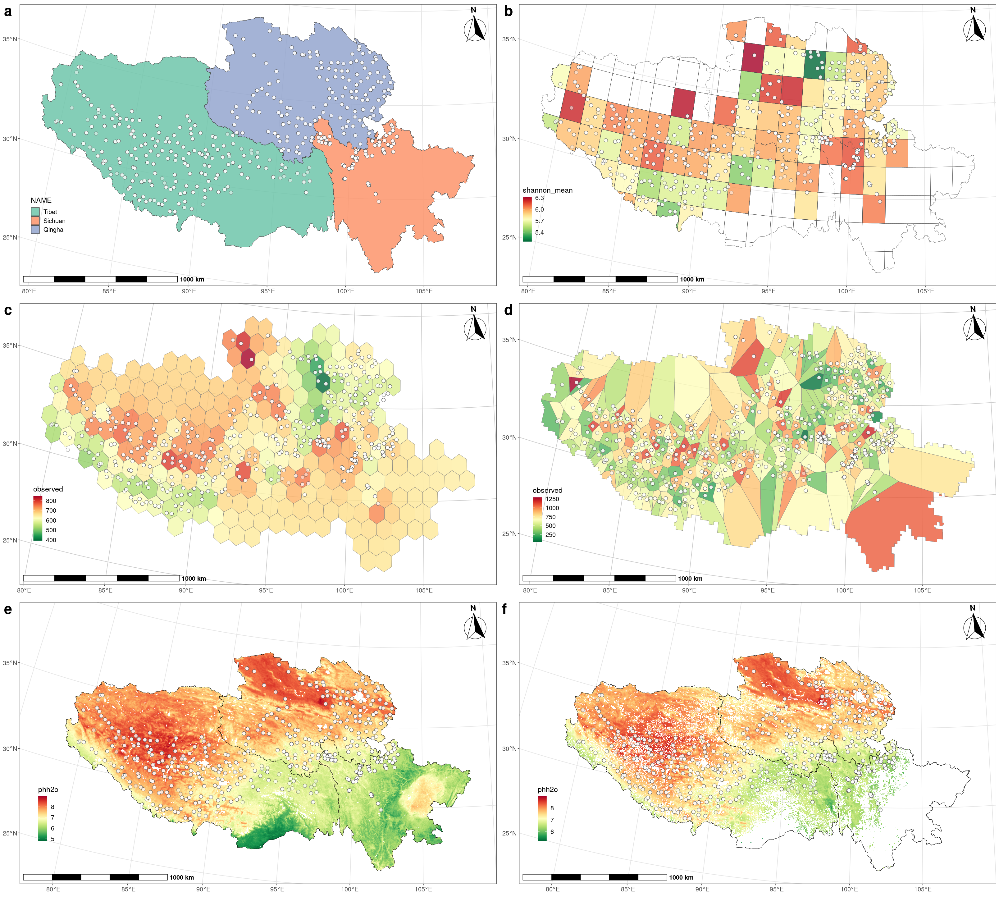

In [45]:
# Add sampling sites without colors 
options(repr.plot.width = 13.4 * 2, repr.plot.height = 8.02 * 3)
s1 <- p4 %>% add_sampl_site(met = dataset.dts$met, color.val = "gray30", fill.val = "white", point.alpha = 0.5) %>% 
    add_scale_bar() %>% add_north_arrow() %>% add_crs()
s2 <- p7 %>% add_sampl_site(met = dataset.dts$met, color.val = "gray30", fill.val = "white", point.alpha = 0.5) %>% 
    add_scale_bar() %>% add_north_arrow() %>% add_crs()
s3 <- p11 %>% add_sampl_site(met = dataset.dts$met, color.val = "gray30", fill.val = "white", point.alpha = 0.5) %>% 
    add_scale_bar() %>% add_north_arrow() %>% add_crs()
s4 <- p9 %>% add_sampl_site(met = dataset.dts$met, color.val = "gray30", fill.val = "white", point.alpha = 0.5) %>% 
    add_scale_bar() %>% add_north_arrow() %>% add_crs()
s5 <- p25 %>% add_sampl_site(met = dataset.dts$met, color.val = "gray30", fill.val = "white", point.alpha = 0.5) %>% 
    add_scale_bar() %>% add_north_arrow() %>% add_crs()
s6 <- p29 %>% add_sampl_site(met = dataset.dts$met, color.val = "gray30", fill.val = "white", point.alpha = 0.5) %>% 
    suppressWarnings() %>% add_scale_bar() %>% add_north_arrow() %>% add_crs()
cowplot::plot_grid(s1, s2, s3, s4, s5, s6, align = 'hv', ncol = 2, labels = c("a", "b", "c", "d", "e", "f"), label_size = 28) %>% suppressWarnings()

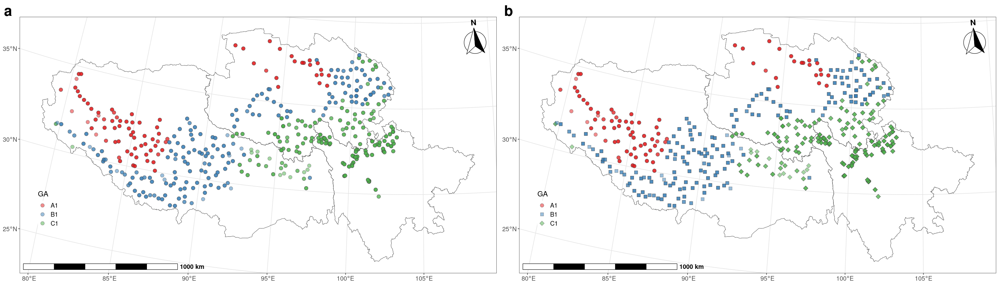

In [46]:
# Add sampling sites with color and shapes [on basic map]
options(repr.plot.width = 13.4 * 2, repr.plot.height = 8.02)
s7 <- p1 %>% add_sampl_site(met = dataset.dts$met, color.var = "GA", color.val = "gray30",point.alpha = 0.5) %>%  
    add_scale_bar() %>% add_north_arrow() %>% add_crs()
s8 <- p1 %>% add_sampl_site(met = dataset.dts$met, color.var = "GA", shape.var = "GA", color.val = "gray30", point.alpha = 0.5) %>%
    add_scale_bar() %>% add_north_arrow() %>% add_crs()
cowplot::plot_grid(s7, s8, align = 'hv', ncol = 2, labels = c("a", "b"), label_size = 28) %>% suppressWarnings()

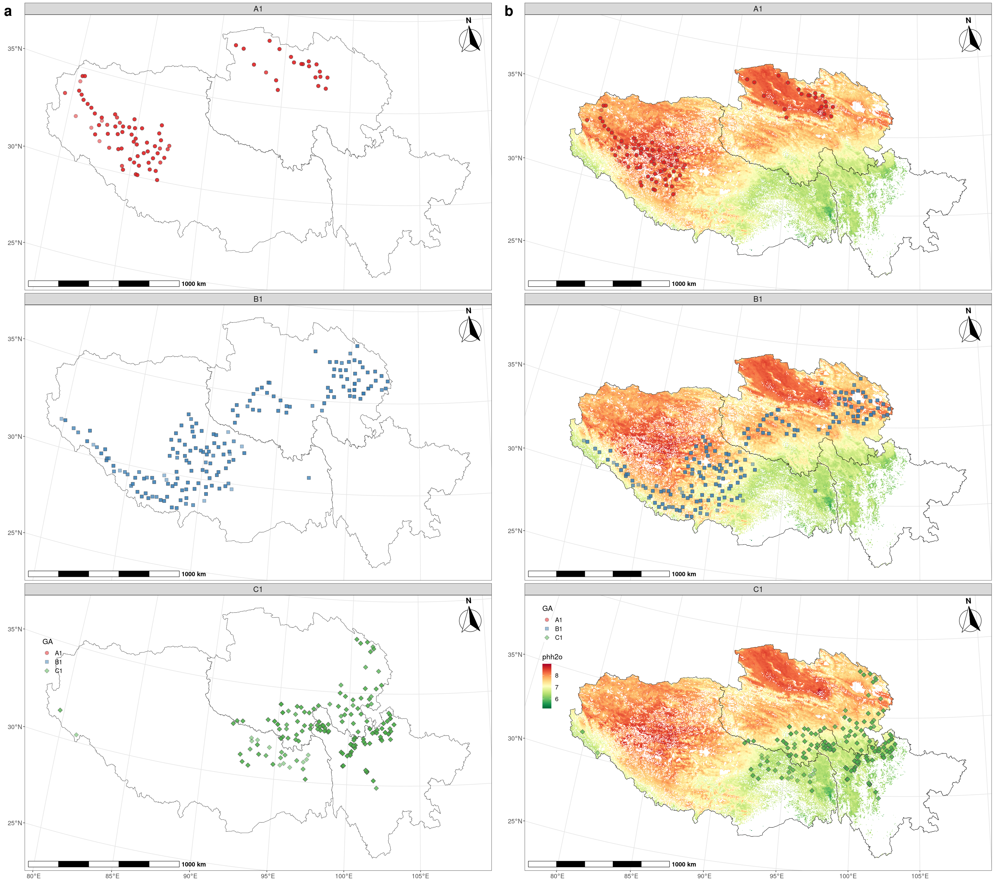

In [47]:
# Facet by one grouping variable
options(repr.plot.width = 13.43 * 2, repr.plot.height = 7.9 * 3)
s9 <- p1 %>% add_sampl_site(met = dataset.dts$met, color.var = "GA", shape.var = "GA", color.val = "gray30", point.alpha = 0.5, facet.by.color = T, facet.col.nums = 1) %>%
      add_scale_bar() %>% add_north_arrow() %>% add_crs()
s10 <- p29 %>% add_sampl_site(met = dataset.dts$met, color.var = "GA", shape.var = "GA", color.val = "gray30", point.alpha = 0.5, facet.by.color = T, facet.col.nums = 1) %>%
       add_scale_bar() %>% add_north_arrow() %>% add_crs()
cowplot::plot_grid(s9, s10, align = 'hv', ncol = 2, labels = c("a", "b"), label_size = 28) %>% suppressWarnings()

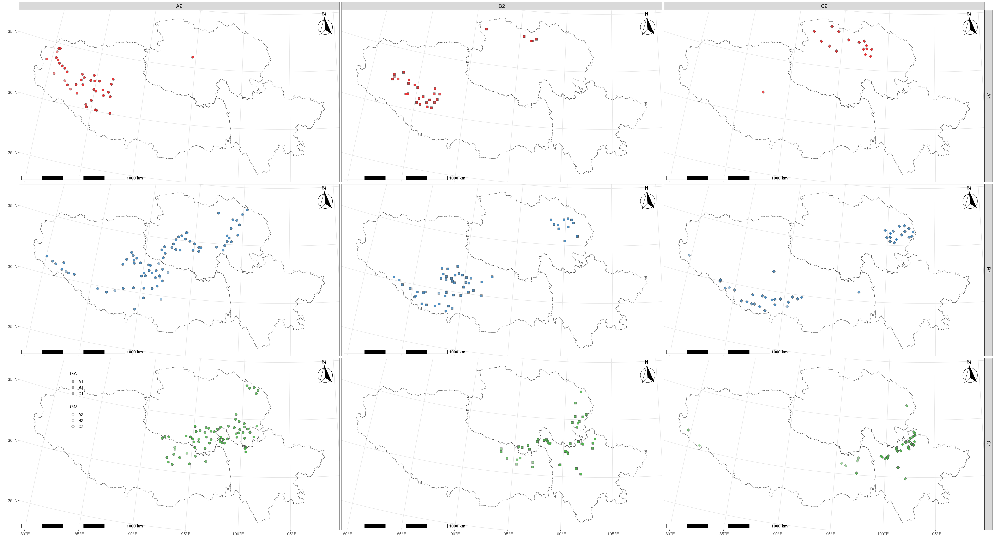

In [48]:
# Facet by two grouping variables [on basic map]
options(repr.plot.width = 13.43 * 3, repr.plot.height = 7.23 * 3)
p1 %>% add_sampl_site(met = dataset.dts$met, color.var = "GA", shape.var = "GM", color.val = "gray30", point.alpha = 0.5, facet.by.color = T, facet.by.shape = T) %>%
       add_scale_bar() %>% add_north_arrow() %>% add_crs()

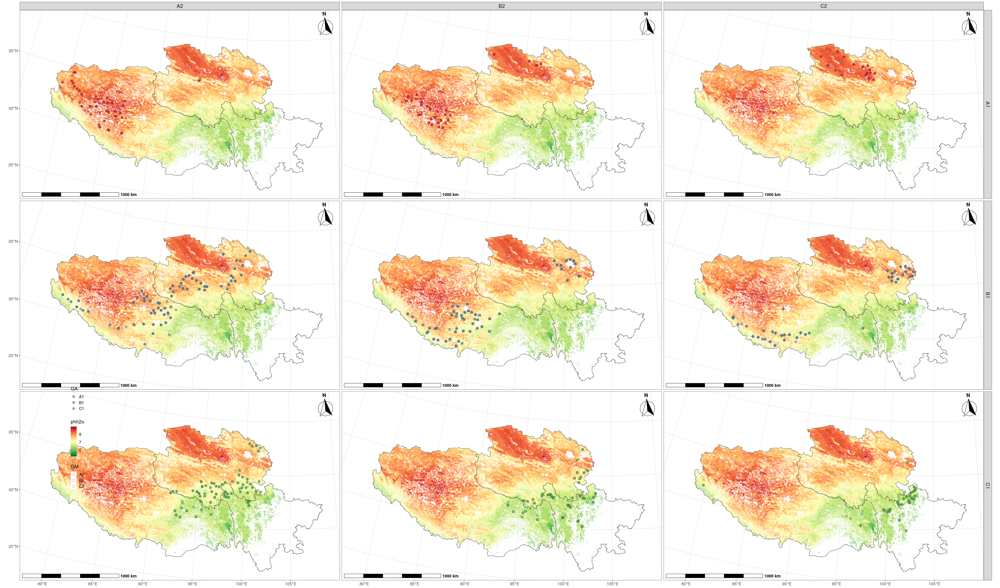

In [49]:
# Facet by two grouping variables [on SpatRaster]
options(repr.plot.width = 13.43 * 3, repr.plot.height = 7.9 * 3)
p29 %>% add_sampl_site(met = dataset.dts$met, color.var = "GA", shape.var = "GM", color.val = "gray30", point.alpha = 0.5, facet.by.color = T, facet.by.shape = T) %>%
        add_scale_bar() %>% add_north_arrow() %>% add_crs()